# Identical data in training and testing datasets

In [1]:
import os 
import numpy as np
import pandas as pd

INPUT_PATH = 'data'
TRAIN_TEST_DATA = os.path.join(INPUT_PATH, 'imgs')
TRAIN_CSV_PATH = os.path.join(INPUT_PATH, 'train.csv')
TEST_CSV_PATH = os.path.join(INPUT_PATH, 'test.csv')

CLASS_CODES_DF = pd.read_csv(os.path.join(INPUT_PATH, 'class_codes.csv'))
TRAIN_CSV_DF = pd.read_csv(TRAIN_CSV_PATH)
TEST_CSV_DF = pd.read_csv(TEST_CSV_PATH)

train_ids = TRAIN_CSV_DF['id'].values
train_classes = TRAIN_CSV_DF['class'].values

test_ids = TEST_CSV_DF['id'].values

In [25]:
import cv2
from skimage.io import imread


def get_filename(image_id, image_type):
    """
    Method to get image file path from its id and type
    """
    check_dir = False
    ext = ''
    prefix = '' 
    if "Train" in image_type: 
        data_path = TRAIN_TEST_DATA
    elif "Test" in image_type:
        data_path = TRAIN_TEST_DATA
    else:
        raise Exception("Image type '%s' is not recognized" % image_type)

    if check_dir and not os.path.exists(data_path):
        os.makedirs(data_path)
    if len(ext) > 0:
        return os.path.join(data_path, "{}{}.{}".format(prefix, image_id, ext))
    return os.path.join(data_path, "{}{}".format(prefix, image_id, ext))    
    
    
def get_label(image_id, image_type):
    return _id_class_gb.get_group(image_id)

    
def get_image_data(image_id, image_type):
    fname = get_filename(image_id, image_type)
    
    img = cv2.imread(fname)
    if img is None:
        img = imread(fname)
        assert img is not None, "Failed to read image : %s, %s" % (image_id, image_type)    
    else:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)    
    return img
    
    
_gb = TRAIN_CSV_DF.groupby('id')
_id_class_gb = _gb['class']    
_gb_test = TEST_CSV_DF.groupby('id')
_id_class_test_gb = _gb_test['class']

In [26]:
import matplotlib.pylab as plt
%matplotlib inline

import seaborn as sns

### Exact matching
train image hash is found in test dataset

In [27]:
%store -r train_images_hashes

In [28]:
%store -r occurencies

In [13]:
from collections import defaultdict
import hashlib
train_images_hashes = defaultdict(list)

In [14]:
for i, image_id in enumerate(train_ids):
    if i % 1000 == 0:
        print("{} / {}".format(i, len(train_ids)))
    img = get_image_data(image_id, "Train")
    h = hashlib.md5(img).hexdigest()
    train_images_hashes[h].append(image_id)

0 / 58351
1000 / 58351
2000 / 58351
3000 / 58351
4000 / 58351
5000 / 58351
6000 / 58351
7000 / 58351
8000 / 58351
9000 / 58351
10000 / 58351
11000 / 58351
12000 / 58351
13000 / 58351
14000 / 58351
15000 / 58351
16000 / 58351
17000 / 58351
18000 / 58351
19000 / 58351
20000 / 58351
21000 / 58351
22000 / 58351
23000 / 58351
24000 / 58351
25000 / 58351
26000 / 58351
27000 / 58351
28000 / 58351
29000 / 58351
30000 / 58351
31000 / 58351
32000 / 58351
33000 / 58351
34000 / 58351
35000 / 58351
36000 / 58351
37000 / 58351
38000 / 58351
39000 / 58351
40000 / 58351
41000 / 58351
42000 / 58351
43000 / 58351
44000 / 58351
45000 / 58351
46000 / 58351
47000 / 58351
48000 / 58351
49000 / 58351
50000 / 58351
51000 / 58351
52000 / 58351
53000 / 58351
54000 / 58351
55000 / 58351
56000 / 58351
57000 / 58351
58000 / 58351


In [15]:
len(train_images_hashes), len(train_ids)

(58246, 58351)

In [16]:
occurencies = []

for i, image_id in enumerate(test_ids):
    if i % 200 == 0:
        print("{} / {}".format(i, len(test_ids)))    
    img = get_image_data(image_id, "Test")
    h = hashlib.md5(img).hexdigest()
    if h in train_images_hashes:
        print("Found occurency: Train, {} vs Test, {}".format(train_images_hashes[h], image_id))
        occurencies.append(((train_images_hashes[h], "Train"), (image_id, "Test")))

0 / 14588
200 / 14588
400 / 14588
Found occurency: Train, [51791] vs Test, 34342
600 / 14588
Found occurency: Train, [1776] vs Test, 48417
800 / 14588
1000 / 14588
Found occurency: Train, [9683] vs Test, 66424
Found occurency: Train, [205] vs Test, 53708
1200 / 14588
1400 / 14588
1600 / 14588
Found occurency: Train, [22691] vs Test, 43902
1800 / 14588
2000 / 14588
Found occurency: Train, [14324] vs Test, 62540
2200 / 14588
Found occurency: Train, [30636, 21851] vs Test, 28797
Found occurency: Train, [20747] vs Test, 20786
2400 / 14588
2600 / 14588
2800 / 14588
Found occurency: Train, [9850] vs Test, 70582
3000 / 14588
3200 / 14588
Found occurency: Train, [33829] vs Test, 36402
3400 / 14588
Found occurency: Train, [15449] vs Test, 21414
Found occurency: Train, [25644] vs Test, 20284
3600 / 14588
Found occurency: Train, [48180] vs Test, 59884
Found occurency: Train, [1864] vs Test, 1334
Found occurency: Train, [9884] vs Test, 68935
3800 / 14588
Found occurency: Train, [15496] vs Test, 22

In [17]:
len(occurencies)

50

(51791, 'Train') (34342, 'Test')
(1776, 'Train') (48417, 'Test')
(9683, 'Train') (66424, 'Test')
(205, 'Train') (53708, 'Test')
(22691, 'Train') (43902, 'Test')
(14324, 'Train') (62540, 'Test')
(30636, 'Train') (28797, 'Test')
(20747, 'Train') (20786, 'Test')
(9850, 'Train') (70582, 'Test')
(33829, 'Train') (36402, 'Test')
(15449, 'Train') (21414, 'Test')
(25644, 'Train') (20284, 'Test')
(48180, 'Train') (59884, 'Test')
(1864, 'Train') (1334, 'Test')
(9884, 'Train') (68935, 'Test')
(15496, 'Train') (22723, 'Test')
(47073, 'Train') (8301, 'Test')
(53026, 'Train') (62170, 'Test')
(24320, 'Train') (32635, 'Test')
(32123, 'Train') (31667, 'Test')
(42259, 'Train') (3644, 'Test')
(30712, 'Train')

/usr/local/lib/python3.5/dist-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


 (66559, 'Test')
(40741, 'Train') (68839, 'Test')
(26692, 'Train') (20042, 'Test')
(33990, 'Train') (24243, 'Test')
(61073, 'Train') (67798, 'Test')
(8345, 'Train') (43048, 'Test')
(27663, 'Train') (14714, 'Test')
(70392, 'Train') (20834, 'Test')
(21847, 'Train') (1006, 'Test')
(22448, 'Train') (51726, 'Test')
(35561, 'Train') (33996, 'Test')
(35819, 'Train') (9692, 'Test')
(43379, 'Train') (5817, 'Test')
(66037, 'Train') (70477, 'Test')
(5084, 'Train') (13850, 'Test')
(49522, 'Train') (57223, 'Test')
(990, 'Train') (14375, 'Test')
(12810, 'Train') (37582, 'Test')
(44969, 'Train') (46110, 'Test')
(54368, 'Train') (43329, 'Test')
(51677, 'Train') (31636, 'Test')
(63874, 'Train') (69631, 'Test')
(35862, 'Train') (12525, 'Test')
(35217, 'Train') (852, 'Test')
(11501, 'Train') (39186, 'Test')
(24053, 'Train') (26473, 'Test')
(40858, 'Train') (57132, 'Test')
(370, 'Train') (57379, 'Test')
(26028, 'Train') (43783, 'Test')


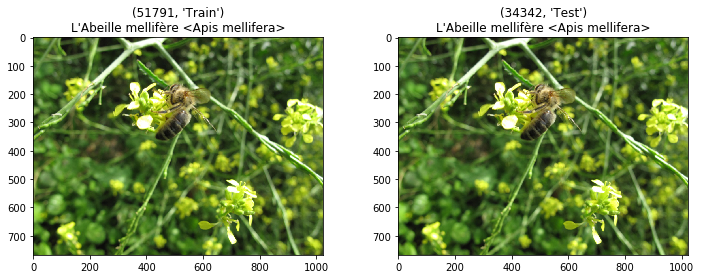

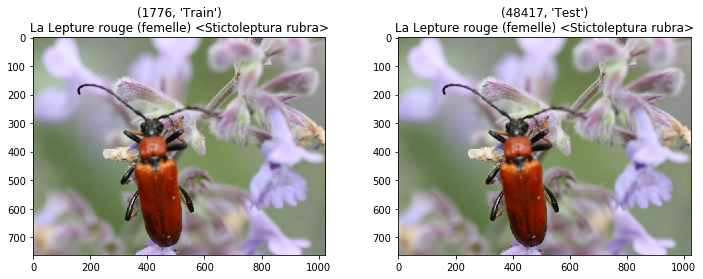

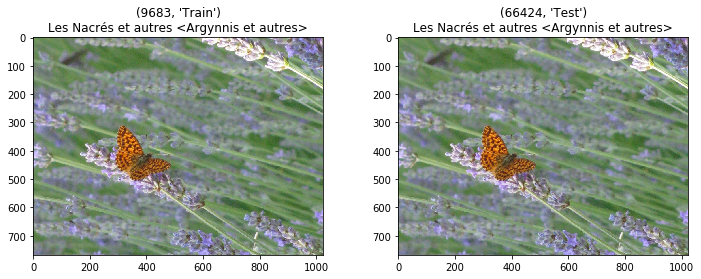

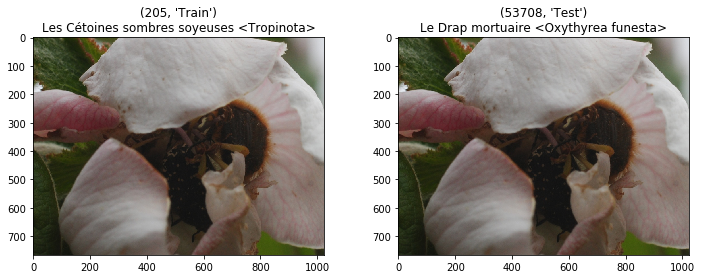

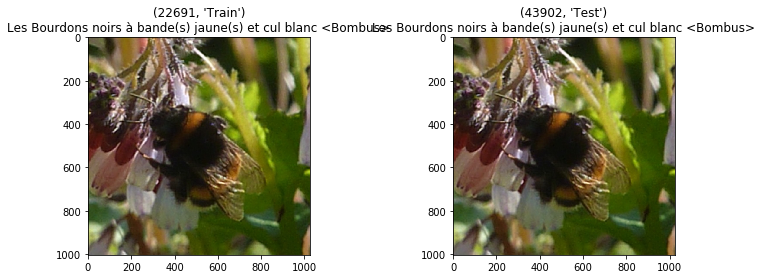

...

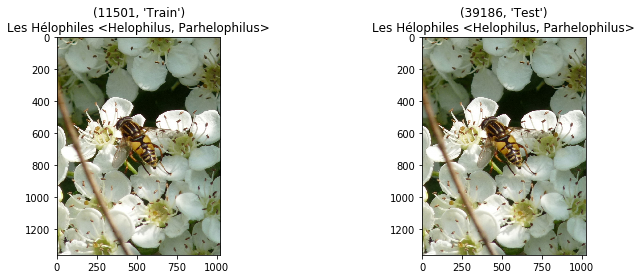

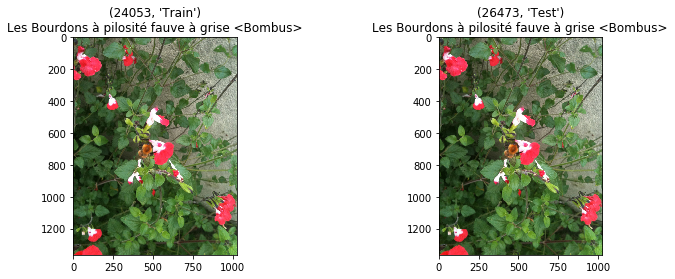

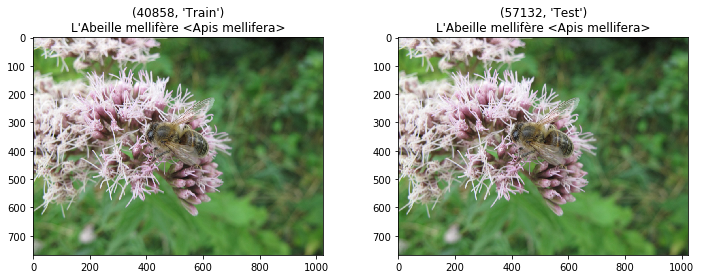

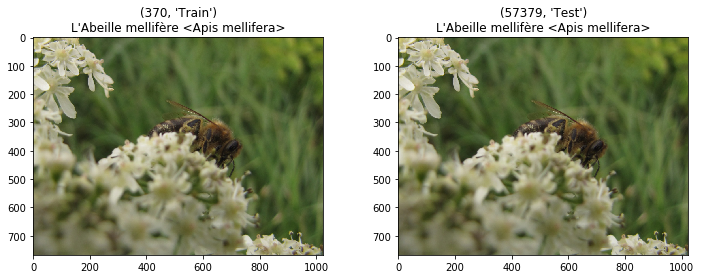

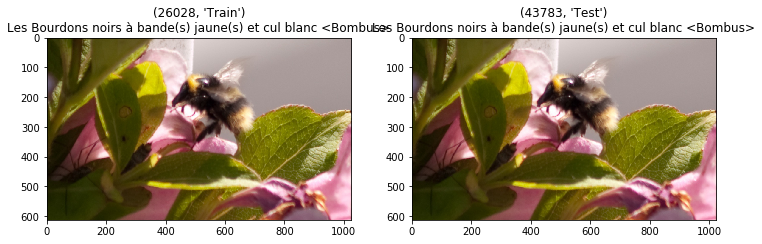

In [36]:
for train_id, test_id in occurencies:
    train_id = (train_id[0][0], train_id[1])
    print(train_id, test_id)
    plt.figure(figsize=(12, 4))
    plt.subplot(121)
    plt.title("{}\n{}".format(train_id, 
                              CLASS_CODES_DF.loc[_id_class_gb.get_group(train_id[0]).values[0],'taxa_name']))
    plt.imshow(get_image_data(*train_id))
    plt.subplot(122)
    plt.title("{}\n{}".format(test_id, 
                              CLASS_CODES_DF.loc[_id_class_test_gb.get_group(test_id[0]).values[0], 'taxa_name']))
    plt.imshow(get_image_data(*test_id))

### Identical data misclassified between train/test datasets:

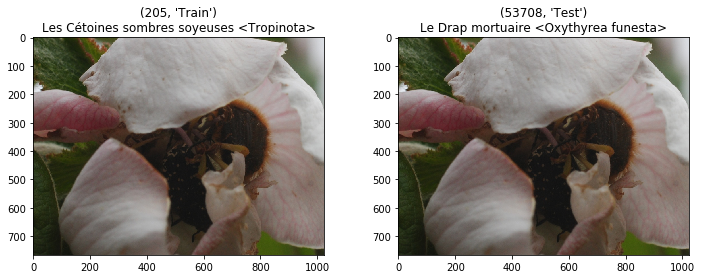

In [30]:
train_id = (205, 'Train')
test_id = (53708, 'Test')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train_id))
plt.subplot(122)
plt.title("{}\n{}".format(test_id, 
                          CLASS_CODES_DF.loc[_id_class_test_gb.get_group(test_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*test_id))


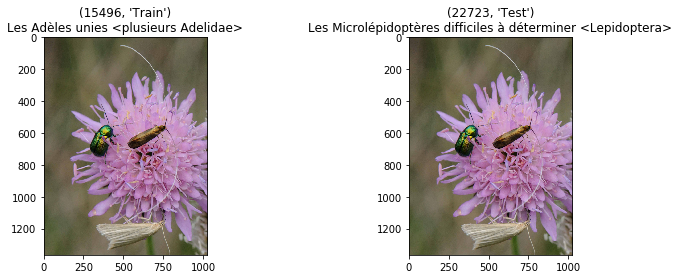

In [37]:
train_id = (15496, 'Train')
test_id = (22723, 'Test')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train_id))
plt.subplot(122)
plt.title("{}\n{}".format(test_id, 
                          CLASS_CODES_DF.loc[_id_class_test_gb.get_group(test_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*test_id))

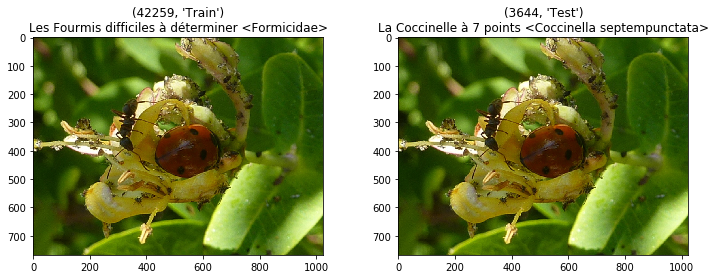

In [38]:
train_id = (42259, 'Train')
test_id = (3644, 'Test')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train_id))
plt.subplot(122)
plt.title("{}\n{}".format(test_id, 
                          CLASS_CODES_DF.loc[_id_class_test_gb.get_group(test_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*test_id))


### Identical images in training dataset

Similar train images: 
[19449, 13559]
[24754, 36507]
[28743, 55654]
[58936, 40587]
[55188, 11060]
[20561, 38874, 65343]
[35417, 58309]
[69990, 9512]
[63923, 20234]
[43609, 62807]
[72762, 37300]
[25320, 28210]
[54304, 60585]
[63886, 44907]
[8189, 46700]
[28115, 70059]
[61477, 17948]
[16580, 719]
[30283, 14306]
[44360, 56318]
[45541, 59927]
[19123, 63356]


/usr/local/lib/python3.5/dist-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


[11807, 37637]
[16742, 32135]
[27814, 53889]
[18492, 8703]
[51677, 54970]
[29060, 44364]
[56667, 48886]
[6695, 67182]
[33971, 61063]
[55145, 47410]
[67079, 45429]
[19350, 35916]
[62861, 72114]
[72403, 20975]
[43549, 43954]
[36467, 70218]
[9631, 2197]
[25051, 39737]
[23625, 2154]
[22211, 62346]
[32136, 58174]
[16270, 17981]
[29077, 34431]
[36067, 52218]
[5889, 66812]
[25807, 33802]
[65770, 39609]
[72824, 64819]
[7285, 45947]
[48770, 54876]
[12739, 69357]
[17485, 21322]
[31686, 24255]
[39963, 70233]
[25743, 54872]
[30636, 21851]
[56862, 45565]
[11284, 12025]
[53048, 20603]
[65517, 63724]
[19843, 7464]
[60262, 48961]
[48521, 72265]
[6386, 15350]
[12810, 72366]
[2917, 49637]
[9525, 7802]
[25441, 10392]
[71429, 26818]
[21178, 42076]
[66515, 63064]
[62697, 22032]
[31569, 35456]
[5462, 19492]
[61646, 927]
[35551, 18950]
[63336, 34151]
[63176, 48331]
[46541, 56348]
[36981, 71490]
[5581, 34122]
[11484, 56287]
[38280, 61254]
[1821, 30165]
[61796, 19945]
[58902, 42039]
[29312, 49669]
[55330, 4792

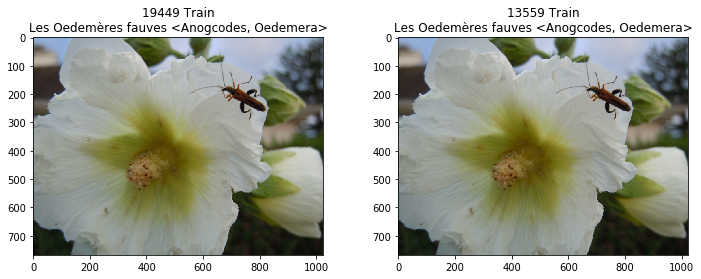

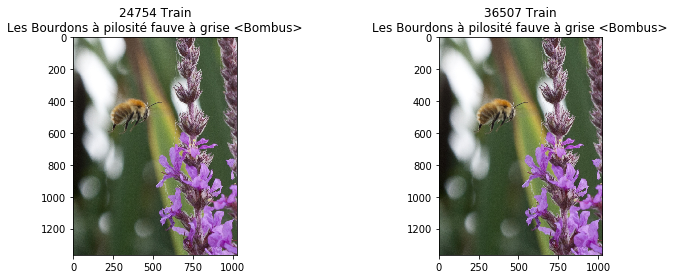

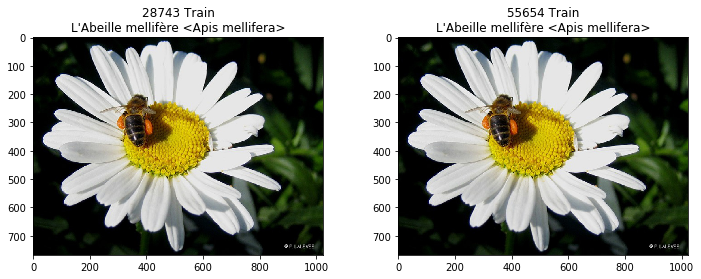

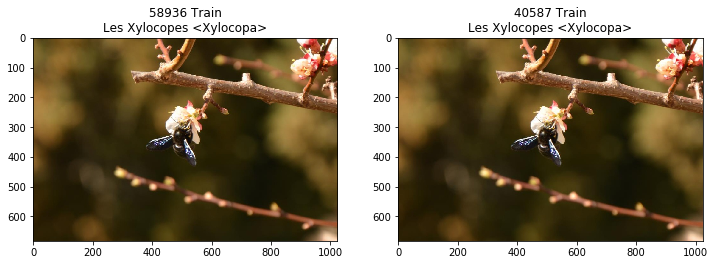

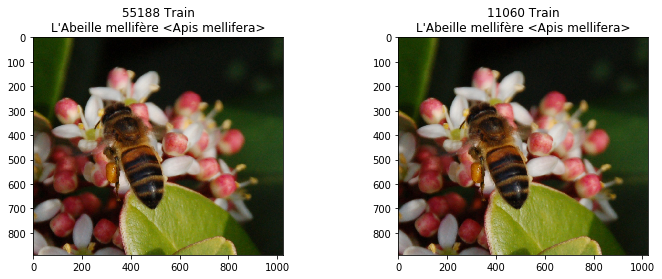

...

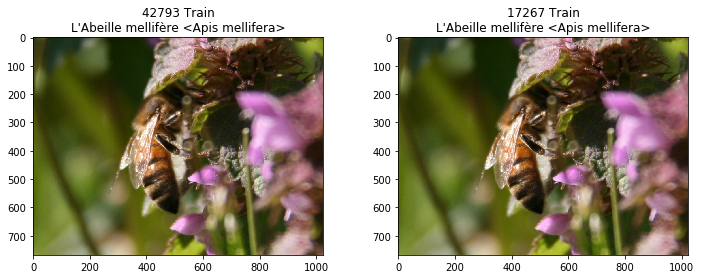

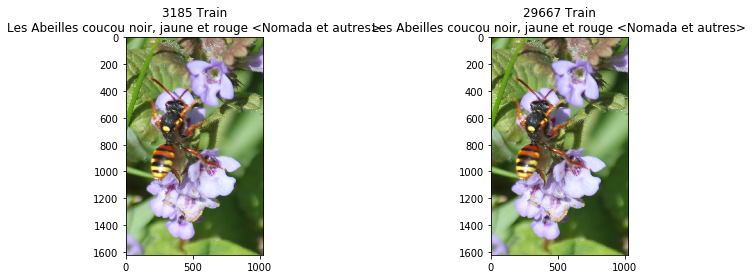

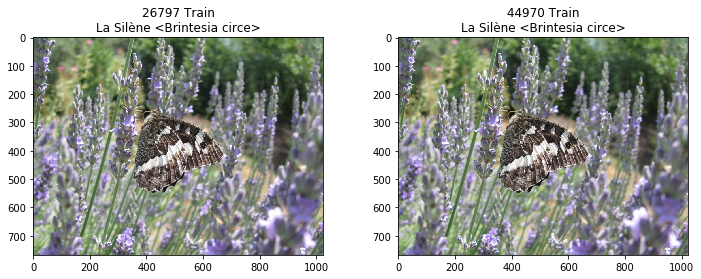

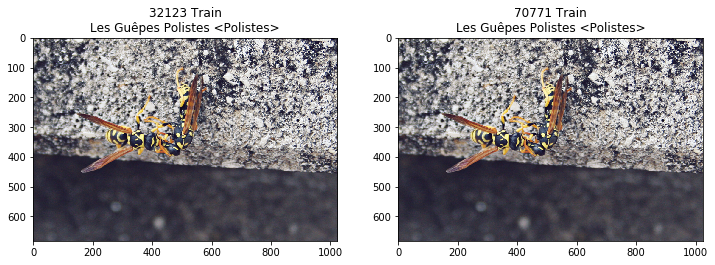

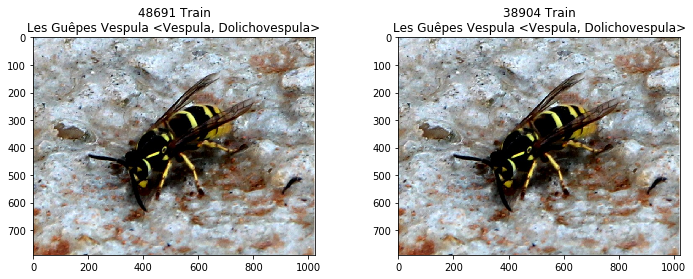

In [39]:
print("Similar train images: ")
for k in train_images_hashes:
    ll = len(train_images_hashes[k])
    if ll > 1:
        image_ids = train_images_hashes[k]
        print(train_images_hashes[k])
        plt.figure(figsize=(12, 4))
        for i in range(ll):
            plt.subplot(1,ll,i+1)
            plt.title("{} Train\n{}".format(image_ids[i], 
                                            CLASS_CODES_DF.loc[_id_class_gb.get_group(image_ids[i]).values[0],'taxa_name']))
            plt.imshow(get_image_data(image_ids[i], "Train"))


### Identical data misclassified training images:

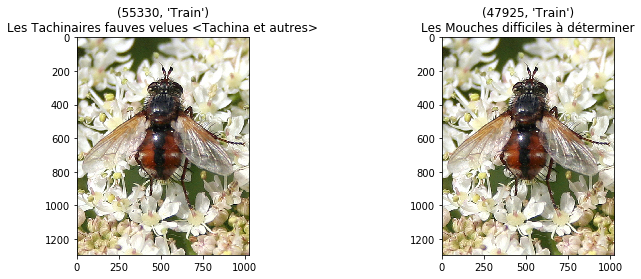

In [48]:
train1_id = (55330, 'Train')
train2_id = (47925, 'Train')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train1_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train1_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train1_id))
plt.subplot(122)
plt.title("{}\n{}".format(train2_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train2_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*train2_id))


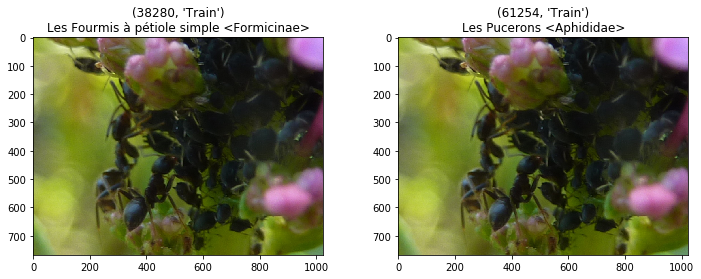

In [47]:
train1_id = (38280, 'Train')
train2_id = (61254, 'Train')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train1_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train1_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train1_id))
plt.subplot(122)
plt.title("{}\n{}".format(train2_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train2_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*train2_id))


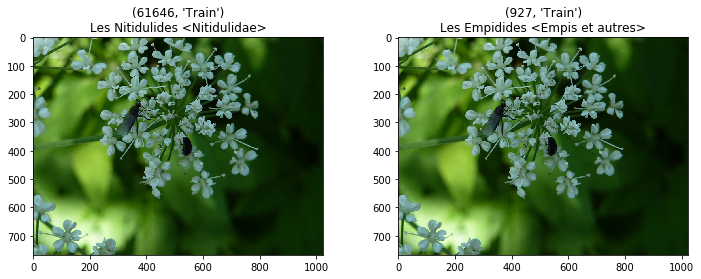

In [46]:
train1_id = (61646, 'Train')
train2_id = (927, 'Train')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train1_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train1_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train1_id))
plt.subplot(122)
plt.title("{}\n{}".format(train2_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train2_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*train2_id))


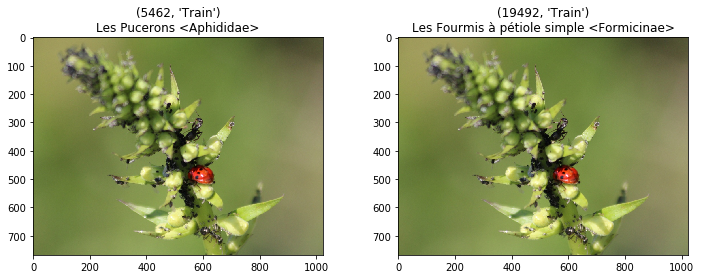

In [45]:
train1_id = (5462, 'Train')
train2_id = (19492, 'Train')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train1_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train1_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train1_id))
plt.subplot(122)
plt.title("{}\n{}".format(train2_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train2_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*train2_id))


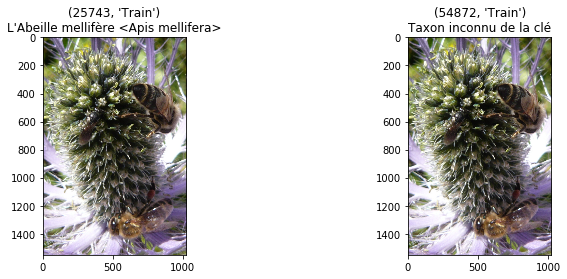

In [43]:
train1_id = (25743, 'Train')
train2_id = (54872, 'Train')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train1_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train1_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train1_id))
plt.subplot(122)
plt.title("{}\n{}".format(train2_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train2_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*train2_id))


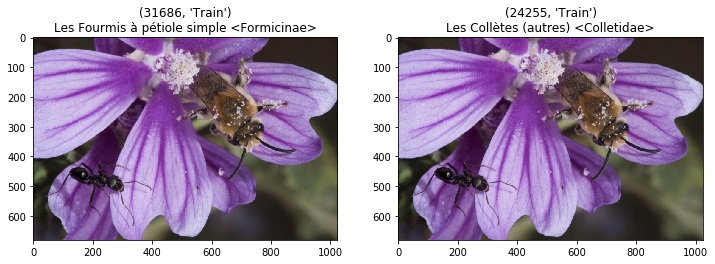

In [42]:
train1_id = (31686, 'Train')
train2_id = (24255, 'Train')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train1_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train1_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train1_id))
plt.subplot(122)
plt.title("{}\n{}".format(train2_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train2_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*train2_id))


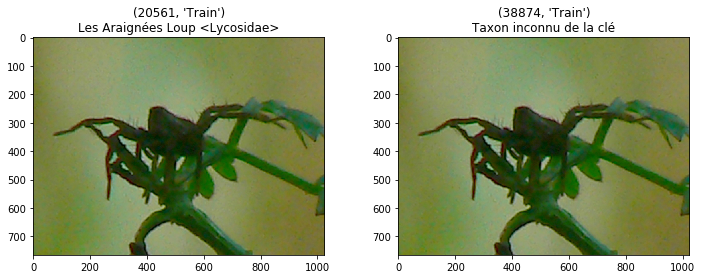

In [40]:
train1_id = (20561, 'Train')
train2_id = (38874, 'Train')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train1_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train1_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train1_id))
plt.subplot(122)
plt.title("{}\n{}".format(train2_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train2_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*train2_id))


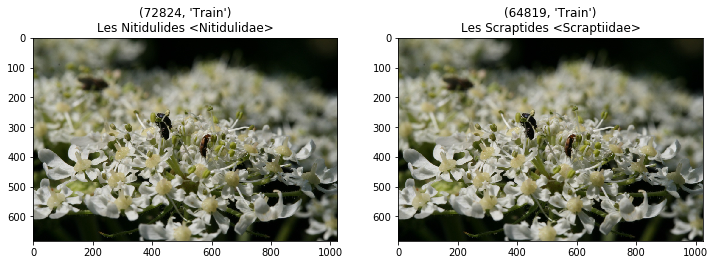

In [41]:
train1_id = (72824, 'Train')
train2_id = (64819, 'Train')
plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.title("{}\n{}".format(train1_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train1_id[0]).values[0],'taxa_name']))
plt.imshow(get_image_data(*train1_id))
plt.subplot(122)
plt.title("{}\n{}".format(train2_id, 
                          CLASS_CODES_DF.loc[_id_class_gb.get_group(train2_id[0]).values[0], 'taxa_name']))
plt.imshow(get_image_data(*train2_id))
